# Lending Clab Exploration
### outliers Identification

After we finished choosing the rellavant parameters and loans to answer our quotation,in this notebook we are proceeding data explortion, with emphasis on the following aspects:

1.Identify data types and data distributions
<p>2.Identify outliers (univariate and multivariate)



In [1]:
if(!require(DBI)){install.packages("DBI"); require(DBI)}
if(!require(RSQLite)){install.packages("RSQLite"); require(RSQLite)}
require(dplyr)

Loading required package: DBI
Loading required package: RSQLite
Loading required package: dplyr

Attaching package: 'dplyr'

The following objects are masked from 'package:stats':

    filter, lag

The following objects are masked from 'package:base':

    intersect, setdiff, setequal, union



In [2]:
##WorkPath
#DATA_PATH = "D:/Google Drive/Final Project/Data"
DB_FILE = ("loans.db") 


In [3]:
###############################################################################
##########                DATABASE FUNCTIONS                     #############
##############################################################################
            
#### Read function to import data from the SQL to a pandas dataframe.
readSQL <- function(query, db=DB_FILE) {
    require(DBI)
    require(RSQLite)
    con <- dbConnect(SQLite(), DB_FILE)
    df <- dbGetQuery(con, query)
    return(df)
}
#### Write a pandas dataframe into an SQL table. Use overwrite=True if you want to delete 
#### first a pre-existent table with the same name. Use append=True if you want to append
#### the data in the dataframe to a pre-existent table.
writeSQL <- function(df,tablename,overwrite=FALSE, append=FALSE,db=DB_FILE) {
    require(DBI)
    require(RSQLite)
    con <- dbConnect(SQLite(), DB_FILE)
    dbWriteTable(con,tablename,df,overwrite,append)
}
####
listTables <- function(db=DB_FILE) {
    require(DBI)
    require(RSQLite)
    con <- dbConnect(SQLite(), DB_FILE)
    ### list the tables on the DB
    res <- dbListTables(con)
    return(res)
} 

In [4]:
listTables(DB_FILE)

[1] "loaners"                 "loaners_credit_history" 
 [3] "loaners_finance"         "loans"                  
 [5] "loans_beforeHotEncoding" "loans_dataset"          
 [7] "loans_finance"           "loans_lc_rating"        
 [9] "povertyRateByStates"     "v_loans"

In [5]:
loans = readSQL("SELECT * From loans_dataset")

In [67]:
dim(loans)

[1] 255720     93

In [7]:
loans_coppy_1<-loans

## Numeric Variables

In [8]:

## numeric variables
nv <- 
  loans %>% 
  sapply(is.numeric) %>% 
  which() %>% 
  names()

m_cat=c('purpose_1', 'purpose_2','purpose_3','purpose_4', 'purpose_5', 'purpose_6' ,'purpose_7' ,'purpose_8',
       'purpose_9', 'purpose_10', 'purpose_11' ,'purpose_12' ,'purpose_13', 'purpose_14', 'seniority_1', 'seniority_2',
       'seniority_3' ,'seniority_4' ,'seniority_5' ,'seniority_6', 'seniority_7', 'seniority_8' ,
       'seniority_9', 'seniority_10','seniority_11' ,'seniority_12',
       'owner_status_1' ,'owner_status_2', 'owner_status_3', 'owner_status_4' ,
       'owner_status_5', 'owner_status_6','default', 'verif_1', 'verif_2' ,'verif_3', 'loan_id', 
        'issue_d', 'pymnt_plan','initial_list_status', 'term','last_pymnt_d' , 'next_pymnt_d', 'last_credit_pull_d','earliest_cr_line',
       "pub_rec")
nv <- nv[!nv %in% m_cat]
nv
length(nv)
### categorical variables
#cv <- 
#  loans %>% 
#  sapply(is.logical) %>% 
#  which() %>% 
#  names()
#num_vars
#length(num_vars)
##           'funded_amnt_inv'  ,'installment' ,'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int', 
 #           'total_rec_late_fee' ,'recoveries' ,'collection_recovery_fee', 'last_pymnt_amnt' , 'collections_12_mths_ex_med',
 #           'mths_since_last_major_derog', 'annual_inc', 'dti', 'delinq_2yrs',
 #           'acc_now_delinq', 'earliest_cr_line', 'inq_last_6mths' ,'mths_since_last_delinq', 'mths_since_last_record', 'open_acc', 
 #           'pub_rec', 'revol_bal' ,'revol_util', 'total_acc' ,'tot_coll_amt', 'tot_cur_bal' ,'open_acc_6m' ,'open_il_6m', 'open_il_12m',
 #          'open_il_24m', 'mths_since_rcnt_il', 'total_bal_il', 'il_util',
 #           'open_rv_12m', 'open_rv_24m' ,'max_bal_bc', 'all_util' ,'total_rev_hi_lim' ,'inq_fi' ,'total_cu_tl', 'inq_last_12m'

[1] "loan_amnt"                   "funded_amnt"                
 [3] "funded_amnt_inv"             "installment"                
 [5] "total_pymnt"                 "total_pymnt_inv"            
 [7] "total_rec_prncp"             "total_rec_int"              
 [9] "total_rec_late_fee"          "recoveries"                 
[11] "collection_recovery_fee"     "last_pymnt_amnt"            
[13] "collections_12_mths_ex_med"  "mths_since_last_major_derog"
[15] "annual_inc"                  "dti"                        
[17] "delinq_2yrs"                 "acc_now_delinq"             
[19] "inq_last_6mths"              "mths_since_last_delinq"     
[21] "mths_since_last_record"      "open_acc"                   
[23] "revol_bal"                   "revol_util"                 
[25] "total_acc"                   "tot_coll_amt"               
[27] "tot_cur_bal"                 "open_acc_6m"                
[29] "open_il_6m"                  "open_il_12m"                
[31] "open_il_24m"                 "mths_since_rcnt_il"         
[33] "total_bal_il"                "il_util"                    
[35] "open_rv_12m"                 "open_rv_24m"                
[37] "max_bal_bc"                  "all_util"                   
[39] "total_rev_hi_lim"            "inq_fi"                     
[41] "total_cu_tl"                 "inq_last_12m"

[1] 42

In [9]:
head(loans[nv])

loan_amnt,funded_amnt,funded_amnt_inv,installment,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,...,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
5000,5000,4975,162.87,5861.071,5831.78,5000.00,861.07,0.00,0.00,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
2500,2500,2500,59.83,1008.710,1008.71,456.46,435.17,0.00,117.08,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
2400,2400,2400,84.33,3003.654,3003.65,2400.00,603.65,0.00,0.00,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
10000,10000,10000,339.31,12226.302,12226.30,10000.00,2209.33,16.97,0.00,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
5000,5000,5000,156.46,5631.378,5631.38,5000.00,631.38,0.00,0.00,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
3000,3000,3000,109.43,3938.144,3938.14,3000.00,938.14,0.00,0.00,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


#### Correlation test??

### Outlier analysis

<b>Univariate Outliers

In [10]:
#Define a function to identify outliers
outlierMatrix <- function(data,threshold=1.5) {
    vn <- names(data)
    outdata <- data.frame(row1=1:nrow(data))
    for(v in vn) {
        if(is.numeric(data[[v]])) {
            outlow <- quantile(data[[v]],probs = 0.25,na.rm = T) 
            outhigh <- quantile(data[[v]],probs = 0.75, na.rm = T)
            irq_level <- (outhigh - outlow) * threshold
            outlow <- outlow - irq_level
            outhigh <- outhigh +  irq_level
            mv <- ifelse(data[[v]] < outlow | data[[v]] > outhigh, 1, 0)
            outdata[v] <- mv
        } else {
            mv <- rep(0,nrow(data))
        }
    }
    outdata$row1 <- NULL
    return(outdata)
}

In [11]:
## Visual determination of univariate outliers using boxplots 
options(repr.plot.width = 8, repr.plot.height = 8)

for (v in loans[nv[c(1:13,15:25)]]) {  boxplot(loans[[v]],main=v)}
#    boxplot(loans[[v]],main=v)
#}
#par(mfrow=c(1,1))


ERROR: Error in .subset2(x, i, exact = exact): no such index at level 1



In [17]:
options(repr.plot.width = 7, repr.plot.height = 3)
par(mfrow=c(1,3))
i <- 1
for(y in 1:length(nv)) {
    hist(sellers[[nv[i]]],main=nv[i])
    i <- i + 1
}


ERROR: Error in hist(sellers[[nv[i]]], main = nv[i]): object 'sellers' not found


#### diplay

Because the database contains many items, we will sample 20,000 items from it, so we can present the information in a simpler way without creating a bias in the presentation.

In [26]:

set.seed(123)
loansp<-loans[nv]
sample<- loansp[sample(nrow(loansp), 20000,), ]


pairs display

Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphica

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warni

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message i

""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning mes

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warni

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):


""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graph

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning mes

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical 

""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warni

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message i

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not 

""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warni

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.c

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning me

""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warni

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):


""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warni

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graph

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning mes

""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning mes

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not 

""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message i

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is

""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy, type, ...):
""na.action" is not a graphical parameter"Warning message in title(...):
""na.action" is not a graphical parameter"Warning message in axis(side = side, at = at, labels = labels, ...):
""na.action" is not a graphical parameter"Warning message in plot.xy(xy.coords(x, y), type = type, ...):
""na.action" is not a graphical parameter"Warning message in plot.window(...):
""na.action" is

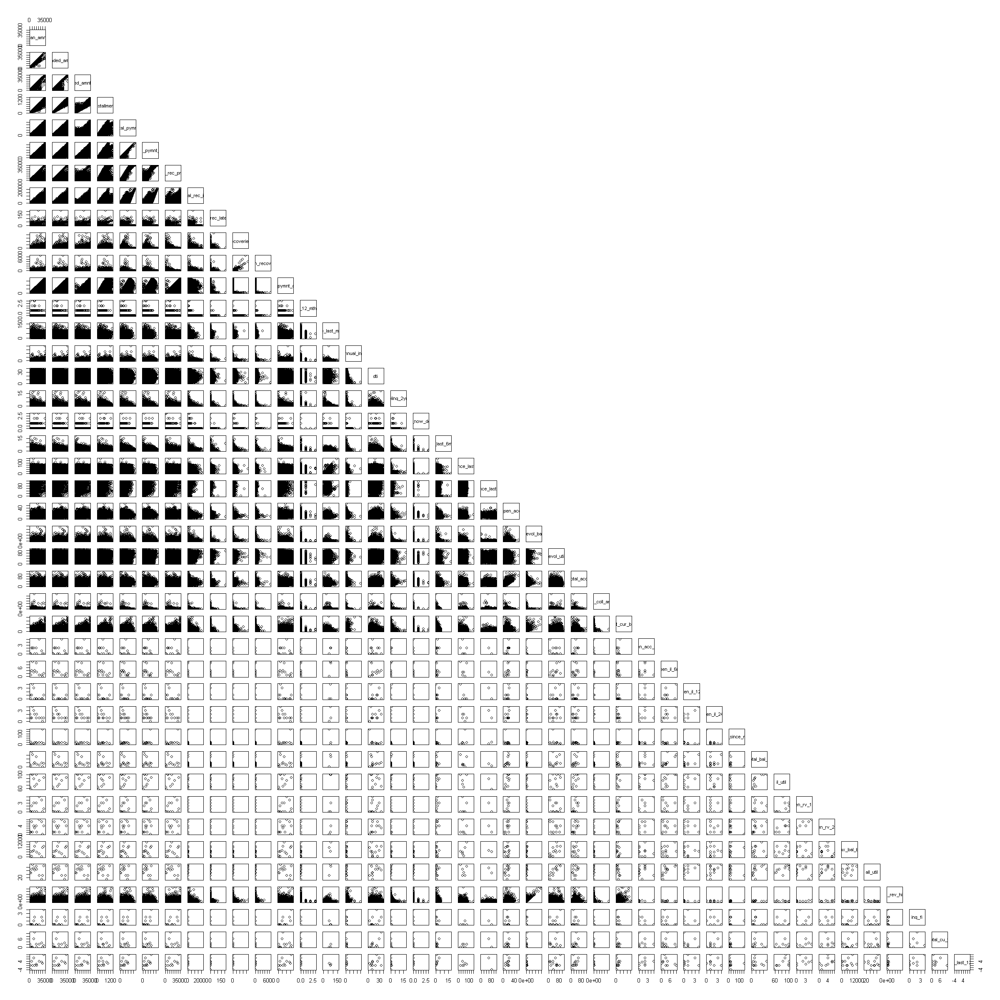

In [28]:
## display  


options(repr.plot.width = 20, repr.plot.height = 20)
pairs(sample,upper.panel=NULL,na.action = na.omit
)
#pairs(loansp[,nv[c(1:13,15:25)]],upper.panel=NULL)


################### כאן יהיה פירוש של הגרף##########################

### Find and labele the outliers

In [44]:
## identify outliers
outlayers<-outlierMatrix(loans[nv])
head(outlayers,10)

loan_amnt,funded_amnt,funded_amnt_inv,installment,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,...,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
0,0,0,0,0,0,0,0,0,0,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
0,0,0,0,0,0,0,0,0,1,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
0,0,0,0,0,0,0,0,0,0,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
0,0,0,0,0,0,0,0,1,0,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
0,0,0,0,0,0,0,0,0,0,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
0,0,0,0,0,0,0,0,0,0,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
0,0,0,0,0,0,0,0,0,1,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
0,0,0,0,0,0,0,0,0,1,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
0,0,0,0,0,0,0,0,0,0,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
0,0,0,0,0,0,0,0,0,0,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


##### (1) loan amount

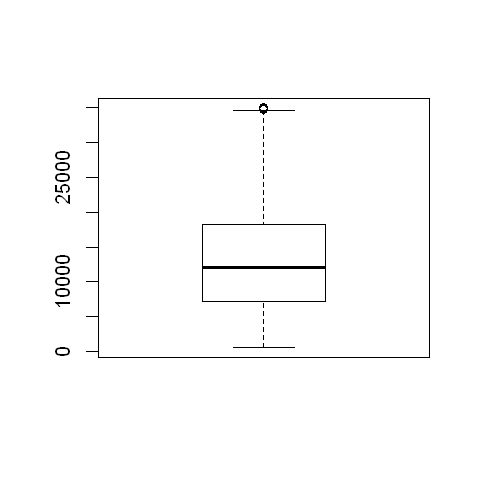

In [29]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt1 <- boxplot(loans$loan_amnt)



we can see that most outlayers are near the outlayers boundary.


In [41]:
head(plt1$out,100)
length(plt1$out)

[1] 35000 35000 35000 35000 35000 35000 35000 35000 34475 35000 35000 35000
 [13] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000
 [25] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000
 [37] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000
 [49] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000
 [61] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000
 [73] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000
 [85] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000
 [97] 35000 35000 35000 35000

[1] 8129

we can see that most of the "outlayers" geting the same valu of 35000! is there any value hitger then 35000?

In [32]:
sum(plt1$out>35000)
sum(plt1$out==35000)
sum(plt1$out<35000)

[1] 0

[1] 8016

[1] 68

From the LC website, as of 2019:                            
<p><i>"Personal loans through LendingClub range from $1,000 to $40,000. The loan offer you receive is based upon what we believe is affordable for you, given the information on your application and credit report. As a marketplace, our goal is to ensure borrowers have a really good shot at successfully repaying their loans."

<b> Therefore, we can conclude that $ 35,000 is in the range of loans given by LC in past years and is not a mistake.
<p><b> The way we decided to handle with the outliers  is to mark mark them .


##### (2) funded_amnt

This parameter has a high correlation with "loan amount", so we expect to see results similar to the "loan amount" test.

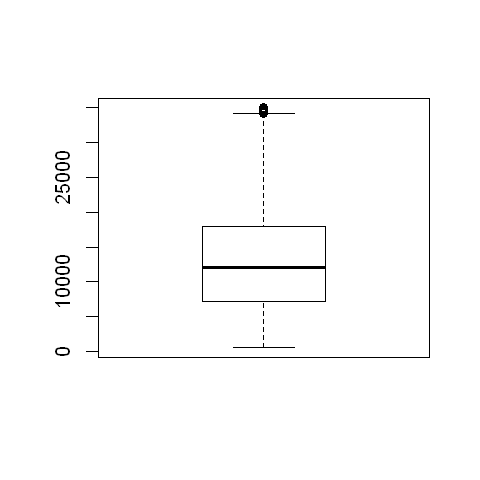

In [37]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt2 <- boxplot(loans$funded_amnt)



we can see that thare is a alot of outlayers just in the outlayers border.

In [38]:

length(plt2$out)
sum(plt2$out>35000)
sum(plt2$out==35000)
sum(plt2$out<35000)

[1] 8129

[1] 0

[1] 7907

[1] 222

<b>Indeed, we can see that the results of testing this parameter are similar to Loan amout testing  results and therefore our conclusion is the same.

##### (3) funded_amnt_inv

This parameter has a high correlation with "loan amount" and "funded_amnt" , so we expect to see results similar to the "loan amount" test.

[1] 35000 35000 35000 35000 35000 35000 35000 35000 34475 35000 35000 35000
[13] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000
[25] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000
[37] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000
[49] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000
[61] 35000 35000 35000 35000 35000 35000 35000 35000 35000 35000

[1] 8129

[1] 0

[1] 7907

[1] 222

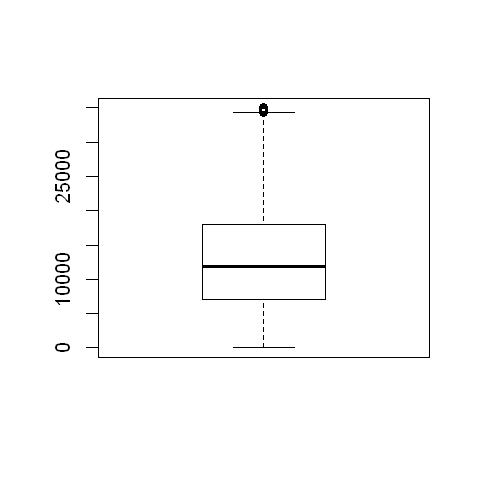

In [48]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt3 <- boxplot(loans$funded_amnt_inv)
head((plt2$out),70)
length(plt2$out)
sum(plt2$out>35000)
sum(plt2$out==35000)
sum(plt2$out<35000)



<b>Indeed, we can see that the results of testing this parameter are exeacly the same to  funded_amnt testing results and therefore our conclusion is the same.

##### (4)installment

[1] 1111.37 1140.07 1111.37 1111.37 1243.85 1200.82 1111.37 1222.03 1111.37
[10] 1095.16 1142.94 1111.37 1106.07 1140.07 1066.16 1095.16 1140.07 1203.66
[19] 1073.62 1283.50 1127.88 1029.27 1062.31 1111.37 1095.16 1140.07 1095.16
[28] 1095.16 1066.16 1269.73 1276.60 1095.16 1095.16 1111.37 1115.55 1082.90
[37] 1095.16 1088.34 1157.66 1140.07 1200.82 1029.27 1100.14 1140.07 1169.54
[46] 1169.54 1095.16 1035.28 1252.56 1269.73 1073.62 1169.54 1173.48 1252.56
[55] 1111.37 1095.16 1067.57 1269.73 1200.82 1243.85 1174.07 1095.16 1269.73
[64] 1111.37 1095.16 1111.37 1095.16 1078.27 1200.82 1113.54

[1] 7068

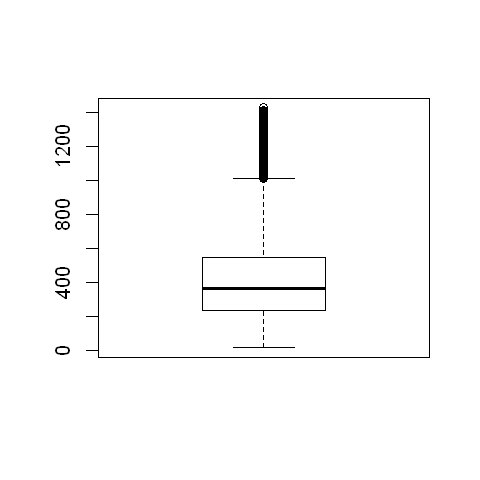

In [54]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt4<- boxplot(loans$installment)
head((plt4$out),70)
length(plt4$out)



[יושלם בהמשך]

<b>(5) total_pymnt

This parameter has a high correlation with "installment" , so we expect to see results similar to the "loan amount" test.

[1] 1111.37 1140.07 1111.37 1111.37 1243.85 1200.82 1111.37 1222.03 1111.37
[10] 1095.16 1142.94 1111.37 1106.07 1140.07 1066.16 1095.16 1140.07 1203.66
[19] 1073.62 1283.50 1127.88 1029.27 1062.31 1111.37 1095.16 1140.07 1095.16
[28] 1095.16 1066.16 1269.73 1276.60 1095.16 1095.16 1111.37 1115.55 1082.90
[37] 1095.16 1088.34 1157.66 1140.07 1200.82 1029.27 1100.14 1140.07 1169.54
[46] 1169.54 1095.16 1035.28 1252.56 1269.73 1073.62 1169.54 1173.48 1252.56
[55] 1111.37 1095.16 1067.57 1269.73 1200.82 1243.85 1174.07 1095.16 1269.73
[64] 1111.37 1095.16 1111.37 1095.16 1078.27 1200.82 1113.54

[1] 7068

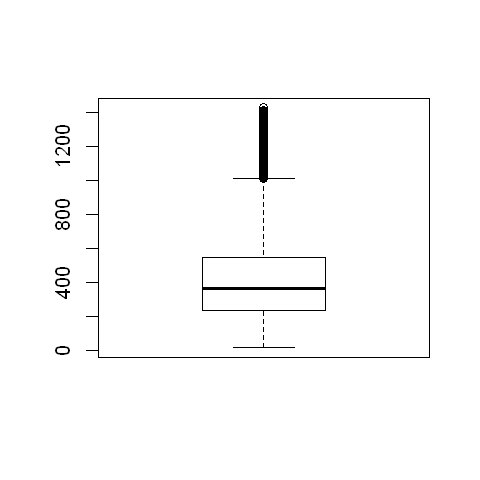

In [55]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt5<- boxplot(loans$installment)
head((plt5$out),70)
length(plt5$out)



<b>Indeed, we can see that the results of testing this parameter are exeacly the same to  
installment testing results and therefore our conclusion is the same

<b> (6) total_pymnt_inv

[1] 35000.00 35000.00 35000.00 35000.00 35000.00 35000.00 35000.00 35000.00
 [9] 34475.00 34975.00 35000.00 35000.00 35000.00 35000.00 35000.00 35000.00
[17] 35000.00 34950.00 34975.00 34960.89 34900.00 34925.00 34961.99 35000.00
[25] 34975.00 34963.33 35000.00 34925.00 35000.00 35000.00 35000.00 34975.00
[33] 34957.18 34975.00 34987.27 34961.85 34975.00 34950.00 35000.00 34972.06
[41] 34975.00 35000.00 34975.00 34963.58 34922.83 34947.54 34972.35 34975.82
[49] 34972.12 35000.00 35000.00 34925.00 34647.35 34700.00 34788.45 34775.00
[57] 35000.00 35000.00 35000.00 34822.57 34825.00 34997.35 34972.48 35000.00
[65] 34975.00 34525.00 34993.66 35000.00 34872.57 35000.00

[1] 8015

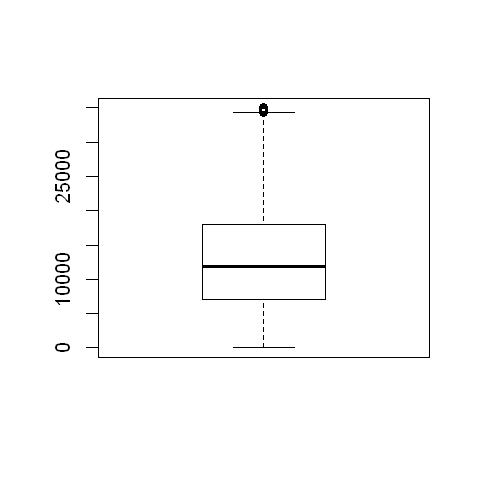

In [61]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt6 <- boxplot(loans$funded_amnt_inv)
head((plt6$out),70)
length(plt6$out)



[יושלם בהמשך]

In [62]:
sum(plt6$out>35000)
sum(plt6$out==35000)
sum(plt6$out<35000)

[1] 0

[1] 6072

[1] 1943

[יושלם בהמשך]

<b> (7) total_rec_prncp

[יושלם בהמשך]

[1] 35000.00 35000.00 35000.00 35000.00 35000.00 35000.00 35000.00 35000.00
 [9] 34475.00 34975.00 35000.00 35000.00 35000.00 35000.00 35000.00 35000.00
[17] 35000.00 34950.00 34975.00 34960.89 34900.00 34925.00 34961.99 35000.00
[25] 34975.00 34963.33 35000.00 34925.00 35000.00 35000.00 35000.00 34975.00
[33] 34957.18 34975.00 34987.27 34961.85 34975.00 34950.00 35000.00 34972.06
[41] 34975.00 35000.00 34975.00 34963.58 34922.83 34947.54 34972.35 34975.82
[49] 34972.12 35000.00 35000.00 34925.00 34647.35 34700.00 34788.45 34775.00
[57] 35000.00 35000.00 35000.00 34822.57 34825.00 34997.35 34972.48 35000.00
[65] 34975.00 34525.00 34993.66 35000.00 34872.57 35000.00

[1] 8015

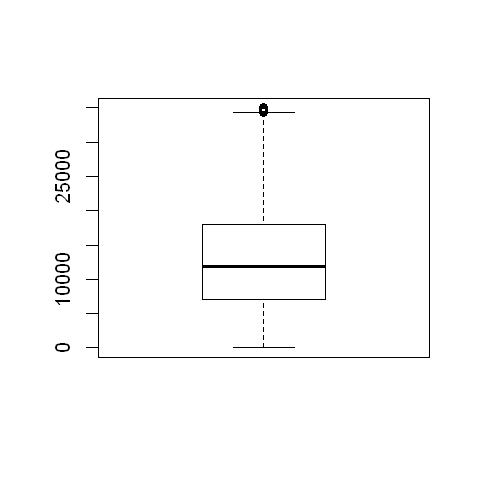

In [63]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt7 <- boxplot(loans$funded_amnt_inv)

head((plt7$out),70)
length(plt7$out)

In [64]:
sum(plt6$out>35000)
sum(plt6$out==35000)
sum(plt6$out<35000)

[1] 0

[1] 6072

[1] 1943

[יושלם בהמשך]

<b>(8) total_rec_int

[1]  7413.04  9328.33  8003.76  6796.92  6786.71  6087.69  8008.11  6085.42
 [9]  6277.26  5980.75  6397.31  6394.08 16255.23  5679.62  7790.84 12835.56
[17]  5809.05 11732.12  6497.29  8369.53  5811.73 11255.08  6864.98  7964.69
[25]  7590.20  9519.89  6512.03  7667.87  5956.20  6021.83  7909.93  6085.50
[33]  6690.74  7063.87  7154.14  5492.77  7577.64  8897.81  7200.35  6719.77
[41]  7590.37  6051.41 13482.63 13927.77  5639.26  5699.18  9675.60  8694.89
[49]  7758.92  6325.58  9399.95  6646.90  6725.29  5878.65 12860.28  6645.38
[57]  5462.04  9519.61  6998.98  6250.02  6983.59  7564.59  6525.43  5768.50
[65]  6114.33  8813.03  7318.78  5798.63 19689.10  8909.65

[1] 17295

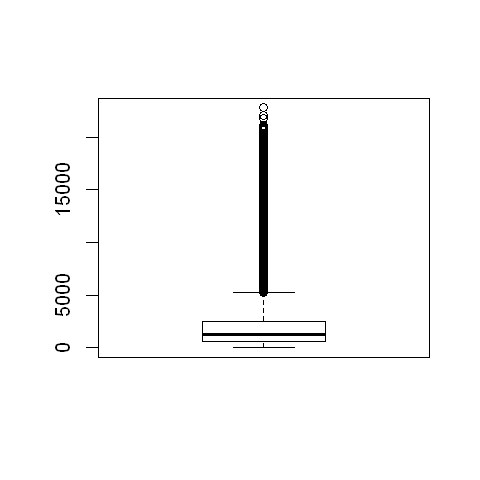

In [71]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt8 <- boxplot(loans$total_rec_int)

head((plt8$out),70)
length(plt8$out)

<b>(9) total_rec_late_fee

[1] 16.97000 15.00000 24.17000 14.98884  1.00000 23.78150 30.00000 36.24700
 [9] 28.76000 15.00000 26.83551 15.00000 14.97906 14.99068 33.68658 32.18000
[17] 14.98116 19.05000 15.00000 19.91219 19.18950 14.99248 17.70000 20.89063
[25] 87.00000 40.42159 24.04805 23.45950 14.99926 15.00000 94.48000 14.99400
[33] 14.88300 80.49258 14.98363 15.00000 15.00000 15.00000 28.75536 15.90464
[41] 15.32000 29.98825 65.88676 17.20000 14.95012 14.97822 14.96837 14.97652
[49] 70.12309 14.96746 14.98160 17.11000 15.00000 14.96316 61.24709 68.85574
[57] 26.97544 30.00000 14.93094 14.97219 15.87000 60.00000 15.30501 21.73000
[65] 14.98461 15.00000 33.05000 59.74782 15.12255 30.86400

[1] 6860

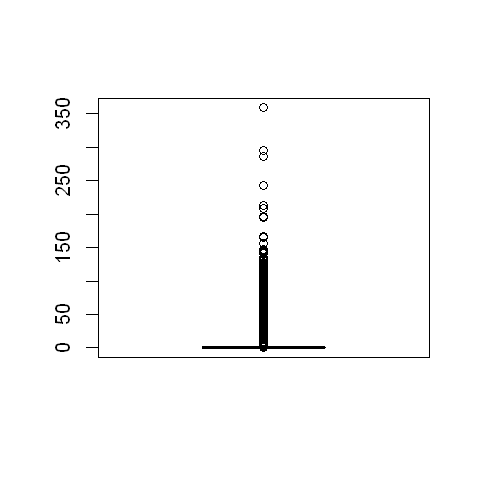

In [73]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt9 <- boxplot(loans$total_rec_late_fee)

head((plt9$out),70)
length(plt9$out)

<b>(10) recoveries

[1]  117.08  189.06  269.29  444.30  645.10  269.31  260.96  107.00  222.81
[10]  578.94  847.30   22.50  381.89   10.29 3486.00  258.27 3343.79  229.06
[19] 2010.58  641.29 3132.16  626.50  414.89  319.46   10.08  459.53   11.91
[28] 1073.61 1084.71   15.16   10.47  543.42  460.64  519.28   64.10 1284.25
[37]  883.68  333.11  150.58   12.02  516.32 1517.32  651.01  298.32 3001.66
[46] 1899.49 1954.88   17.68 1024.88  444.88  308.22 1032.31  660.29 3842.06
[55]  266.46  745.46 1434.48  254.92  526.45   68.75   56.89  408.75   10.66
[64] 1711.17 1525.73  571.11   10.92  189.44  815.11   14.70

[1] 24677

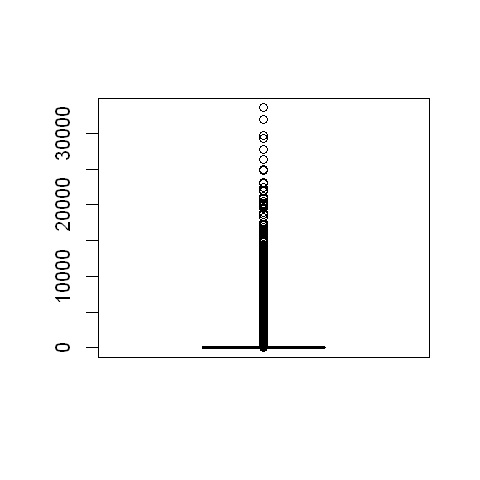

In [74]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt10<- boxplot(loans$recoveries)

head((plt10$out),70)
length(plt10$out)

<b>(11) collection_recovery_fee

[1]   1.1100   2.0900   2.5200   4.1600   6.3145   2.5700   2.3000   1.0700
 [9]  36.3708   5.4900 152.5140   3.6000 625.6170   2.5400 575.2393   2.2906
[17] 361.9044   6.4129 563.7888   6.2650   4.1489  57.5028   4.4878  10.4800
[25]  40.7831   5.6400   1.7799   5.3200   4.6400   5.0368  11.5380  12.2700
[33] 156.0204   3.1464   1.5500   5.0436  15.1732 117.1818   3.0900  30.0166
[41]  18.8164  19.5488   3.1824   9.8900   4.5500   3.2700  10.2500   6.4601
[49] 687.7800   2.9600   7.4546  14.0952   2.8200   5.0643   0.6500  10.2402
[57]   3.8800  17.1117 268.0326   5.6700   1.9656   1.8944 146.7198   9.1696
[65] 317.1046  11.8034   6.2600   1.4900   1.7600   1.0403

[1] 23507

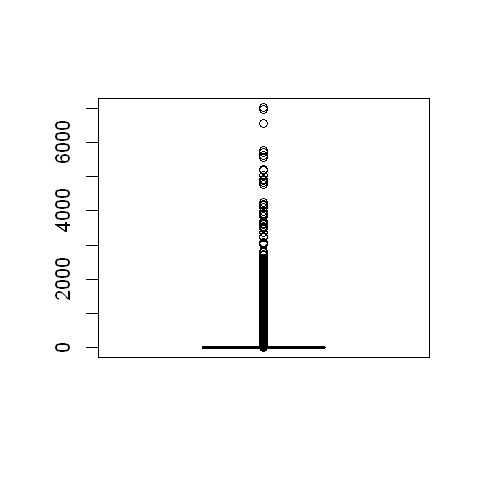

In [75]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt11<- boxplot(loans$collection_recovery_fee)

head((plt11$out),70)
length(plt11$out)

<b>(12) last_pymnt_amnt

[1] 28412.43 26684.35 27308.49 25316.64 24408.49 33330.57 29718.80 30045.31
 [9] 24454.38 30886.74 27495.16 24713.99 34852.54 25657.41 34981.66 26391.58
[17] 34675.92 30340.50 30400.93 26595.62 25398.61 30523.44 24620.71 27997.64
[25] 29942.85 28995.63 25565.17 31208.16 33968.45 28651.22 24934.84 24913.98
[33] 31517.59 30061.06 33774.54 24921.73 27131.44 24545.32 28531.89 26518.07
[41] 24306.87 29453.89 29063.76 25383.32 24276.39 24726.07 27806.95 35596.41
[49] 29391.52 24384.94 28694.29 29202.16 31085.23 25785.88 27838.82 24873.08
[57] 24712.32 28162.15 34115.16 27156.09 29750.87 28101.18 24922.90 25987.95
[65] 35395.59 24858.60 26781.60 28408.17 36115.20 26296.21

[1] 8990

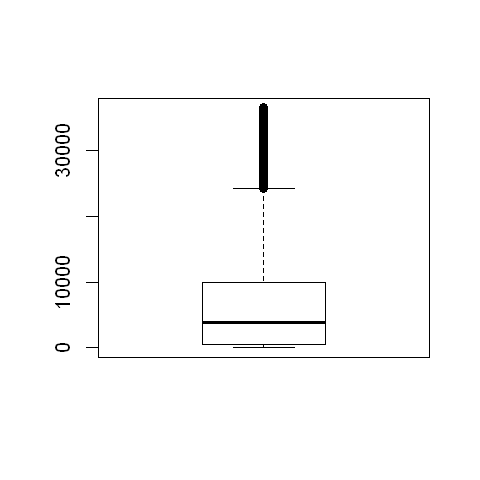

In [80]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt12<- boxplot(loans$last_pymnt_amnt)

head((plt12$out),70)
length(plt12$out)

<b>(13) collections_12_mths_ex_med

[1] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1
[39] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

[1] 1574

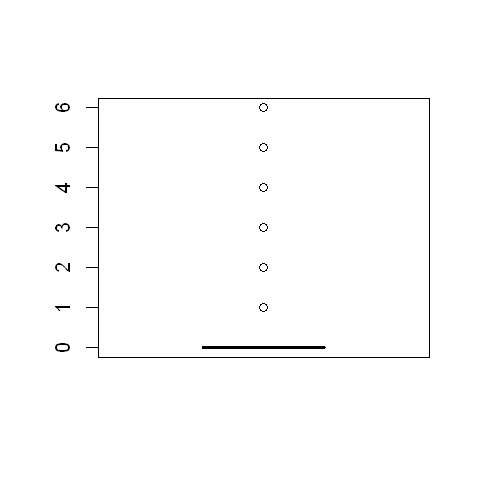

In [79]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt13<- boxplot(loans$collections_12_mths_ex_med)

head((plt13$out),70)
length(plt13$out)

<b>(14)  mths_since_last_major_derog

[1] 152 122 134 122 119 113 120 139 131 141 115 116 148 116 152 134 137 114 122
[20] 128 114 133 122 154 121 151 135 120 118 142 114 137 122 120 113 142 114 128
[39] 125 132 134 135 112 133 123 114 120 114 136 119 127 114 118 130 121 132 142
[58] 125 119 131 114 122 118 113 119 133 140 113 120 115

[1] 155

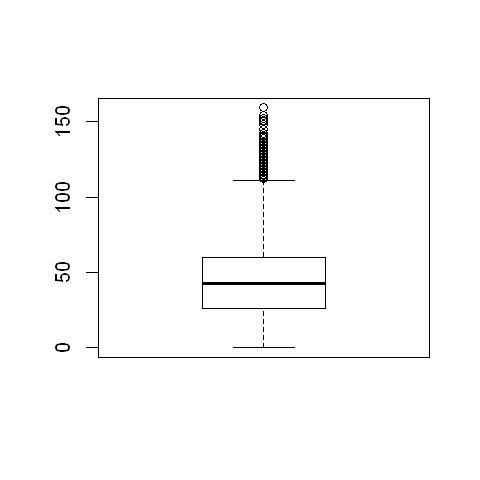

In [78]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt14<- boxplot(loans$mths_since_last_major_derog)

head((plt14$out),70)
length(plt14$out)

<b>(15) annual_inc

[1] 225000 168000 155000 208000 276000 231252 163000 160000 156000 150500
[11] 235000 235000 175000 180000 200000 165000 175000 165000 243600 152000
[21] 170000 264000 210000 200000 170000 160000 525000 180000 160000 158000
[31] 220000 280000 300000 220000 220000 180000 168000 250000 365000 550000
[41] 325000 200000 200000 170000 189996 200000 175000 171600 170000 350000
[51] 165000 152004 200000 158000 160000 180000 300000 225000 159500 200000
[61] 250000 161000 165000 281000 277000 220000 408000 160000 162480 162000

[1] 10721

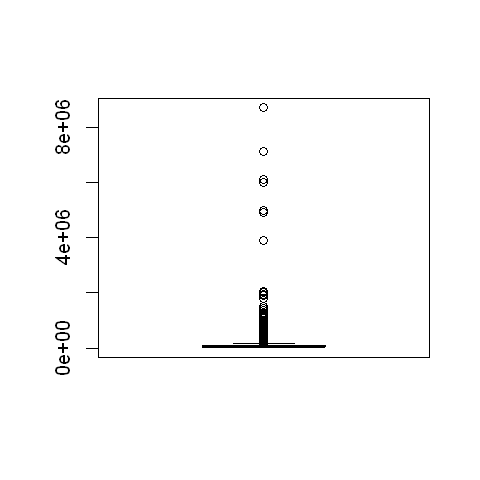

In [85]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt15<- boxplot(loans$annual_inc)

head((plt15$out),70)
length(plt15$out)

<b>(16) dti

[1] 38.86 39.41 39.30 39.63 39.86 39.70 39.81 39.49 39.52 38.98 39.96 39.39
[13] 39.66 38.88 39.74 39.98 39.68 39.45 39.75 39.53 39.47 39.52 39.52 39.79
[25] 39.55 39.11 39.54 39.73 39.17 38.85 39.13 38.98 39.69 39.28 39.48 39.70
[37] 39.12 39.43 39.15 39.66 39.50 39.87 38.84 39.89 39.49 38.98 38.99 38.87
[49] 39.60 39.07 39.17 39.21 39.66 39.70 38.94 38.98 39.31 39.95 39.05 39.91
[61] 38.94 39.41 39.13 38.88 39.76 39.59 39.88 39.63 39.72 39.32

[1] 295

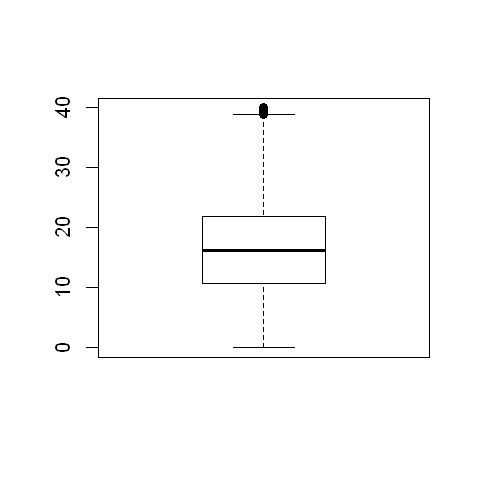

In [86]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt16<- boxplot(loans$dti)

head((plt16$out),70)
length(plt16$out)

In [88]:
min(loans$dti)
quantile(x = loans$dti)

[1] 0

0%   25%   50%   75%  100% 
 0.00 10.73 16.18 21.97 39.99

<b>(17) delinq_2yrs


[1] 2 3 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 2 2 1 3 2 2 1 1 2 2 2 1 1
[39] 3 1 1 1 3 2 1 1 1 1 2 1 1 1 1 1 1 2 1 2 1 2 2 1 1 1 1 1 1 1 1 2

[1] 41148

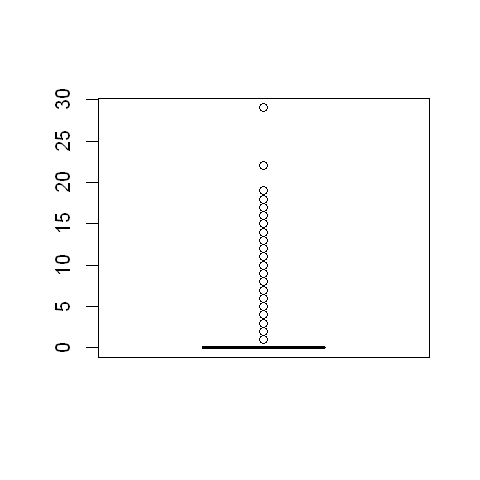

In [109]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt17<- boxplot(loans$delinq_2yrs)

head((plt17$out),70)
length(plt17$out)

In [106]:
min(loans$delinq_2yrs,  na.rm=TRUE)
quantile(x = loans$delinq_2yrs, na.rm=TRUE)
sum(loans$delinq_2yrs==0,  na.rm=TRUE)
sum(loans$delinq_2yrs!=0,  na.rm=TRUE)

[1] 0

0%  25%  50%  75% 100% 
   0    0    0    0   29

[1] 214543

[1] 41148

In [114]:
(loans$delinq_2yrs!=0)==(plt17$out)

Warning message in (loans$delinq_2yrs != 0) == (plt17$out):
"longer object length is not a multiple of shorter object length"

[1] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
   [13] FALSE FALSE FALSE FALSE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
   [25] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
   [37] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
   [49] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
   [61] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
   [73] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
   [85] FALSE FALSE FALSE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
   [97] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [109] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [121] FALSE FALSE FALSE FALSE FALSE FALSE FALSE  TRUE FALSE FALSE FALSE FALSE
  [133] FALSE FALSE FALSE FALSE FALSE FALSE  TRUE  TRUE FALSE FALSE FALSE FALSE
  [145] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [157] FALSE FALSE FALSE FALSE  TRUE FALSE FALSE FALSE FALSE  TRUE FALSE FALSE
  [169] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [181] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [193] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [205] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE  TRUE FALSE FALSE
  [217] FALSE FALSE FALSE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [229] FALSE FALSE FALSE FALSE FALSE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE
  [241] FALSE FALSE FALSE FALSE FALSE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE
  [253] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [265] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [277] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [289] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE  TRUE
  [301] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [313]  TRUE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [325] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE  TRUE FALSE FALSE FALSE
  [337] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [349] FALSE FALSE FALSE FALSE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [361] FALSE FALSE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE FALSE  TRUE FALSE
  [373] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [385] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [397] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [409] FALSE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [421] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE  TRUE FALSE FALSE
  [433] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [445] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [457] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [469] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [481] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [493] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [505] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE  TRUE FALSE FALSE FALSE
  [517] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [529] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [541] FALSE FALSE FALSE FALSE FALSE FALSE FALSE  TRUE FALSE FALSE FALSE FALSE
  [553] FALSE FALSE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [565] FALSE FALSE FALSE FALSE FALSE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE
  [577] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [589] FALSE FALSE  TRUE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
  [6

most of the values are eual to zero, and all the 41148 "outlaiers" are the values that are difer from zero.
ther for, for now, we dicided mark all the number that are differ from zero

<b>(18) acc_now_delinq

[1] 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 3 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1
[39] 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 5 1 1 1 1 1

[1] 739

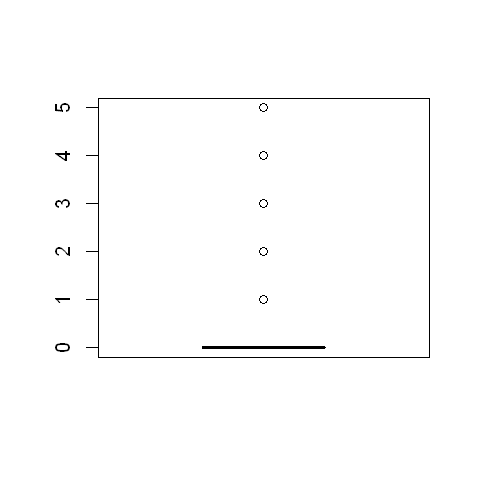

In [110]:
options(repr.plot.width = 4, repr.plot.height = 4)
plt18<- boxplot(loans$acc_now_delinq)

head((plt18$out),70)
length(plt18$out)

In [111]:
min(loans$acc_now_delinq,  na.rm=TRUE)
quantile(x = loans$acc_now_delinq, na.rm=TRUE)
sum(loans$acc_now_delinq==0,  na.rm=TRUE)
sum(loans$acc_now_delinq!=0,  na.rm=TRUE)

[1] 0

0%  25%  50%  75% 100% 
   0    0    0    0    5

[1] 254952

[1] 739

most of the values are eual to zero, and all the 41148 "outlaiers" are the values that are difer from zero. ther for, for now, we dicided mark all the number that are differ from zero

In [ ]:
<b>(19) inq_last_6mths

In [ ]:
<b>(20) mths_since_last_delinq

In [ ]:
<b>(21) mths_since_last_record

In [ ]:
<b>(22) open_acc

In [ ]:
<b>(23) revol_bal

In [ ]:
<b>(24) revol_util

In [ ]:
<b>(25) total_acc

In [ ]:
<b>(26) tot_coll_amt

In [ ]:
<b>(27) tot_cur_bal

In [ ]:
<b>(28) open_acc_6m

In [ ]:
<b>(29) open_il_6m

In [ ]:
<b>(30) open_il_12m

In [ ]:
<b>(31) open_il_24m

In [ ]:
<b>(32) mths_since_rcnt_il

In [ ]:
<b>(33) total_bal_il

In [ ]:
<b>(34) il_util

In [ ]:
<b>(35) open_rv_12m

In [ ]:
<b>(36) open_rv_24m

In [ ]:
<b>(37) max_bal_bc

In [ ]:
<b>(38) all_util

In [ ]:
<b>(39) total_rev_hi_lim

In [ ]:
<b>(40) inq_fi

In [ ]:
<b>(41) total_cu_tl

<b>(42) inq_last_12m

### Multivariable Outliers

   Mode   FALSE    TRUE 
logical     853      48 

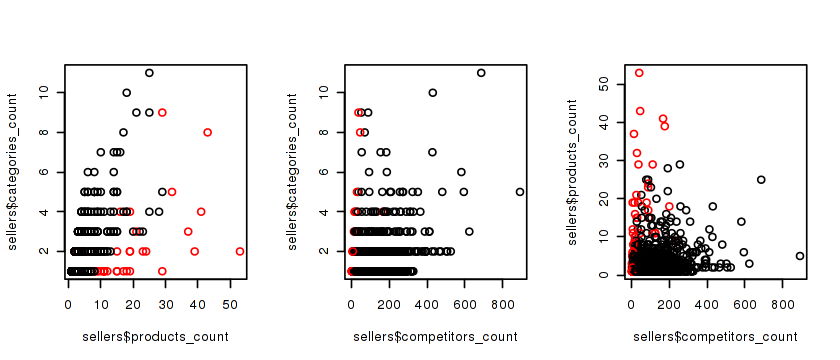

In [84]:
library(mvoutlier)
## multivariate outliers

mout <- mvoutlier.CoDa(sellers[,nv])
summary(mout$outliers)
par(mfrow=c(1,3))
plot(sellers$categories_count ~ sellers$products_count, col=mout$outliers+1)
plot(sellers$categories_count ~ sellers$competitors_count, col=mout$outliers+1)
plot(sellers$products_count ~ sellers$competitors_count, col=mout$outliers+1)


### Most common causes of outliers

* Data entry errors (human errors)
* Measurement error (instrument errors)
* Experimental errors (data extraction planning/executing errors)
* Intentional (made to test detection methods)
* Processing errors (data manipulation or by imputation)
* Sampling errors (data from a different distribution/source)
* Natural (not an error, novelty in data)
 

## Categorical Variables

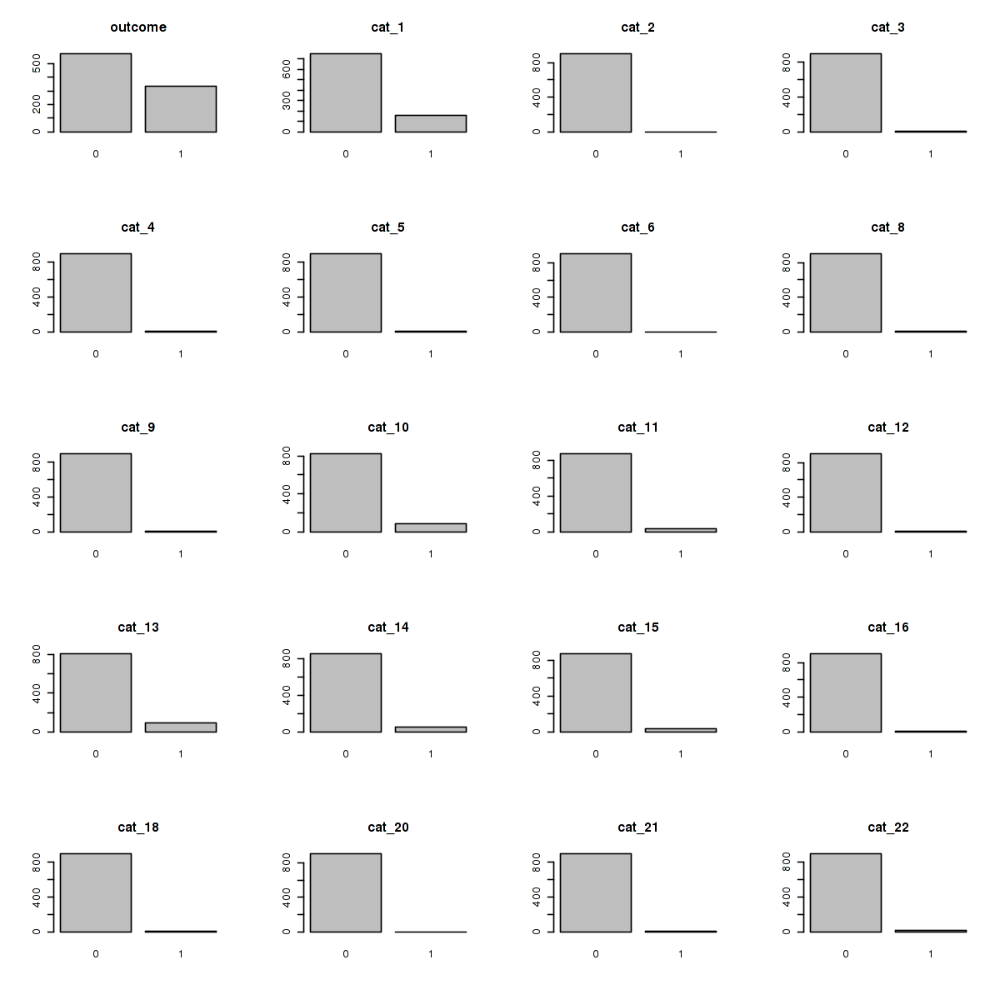

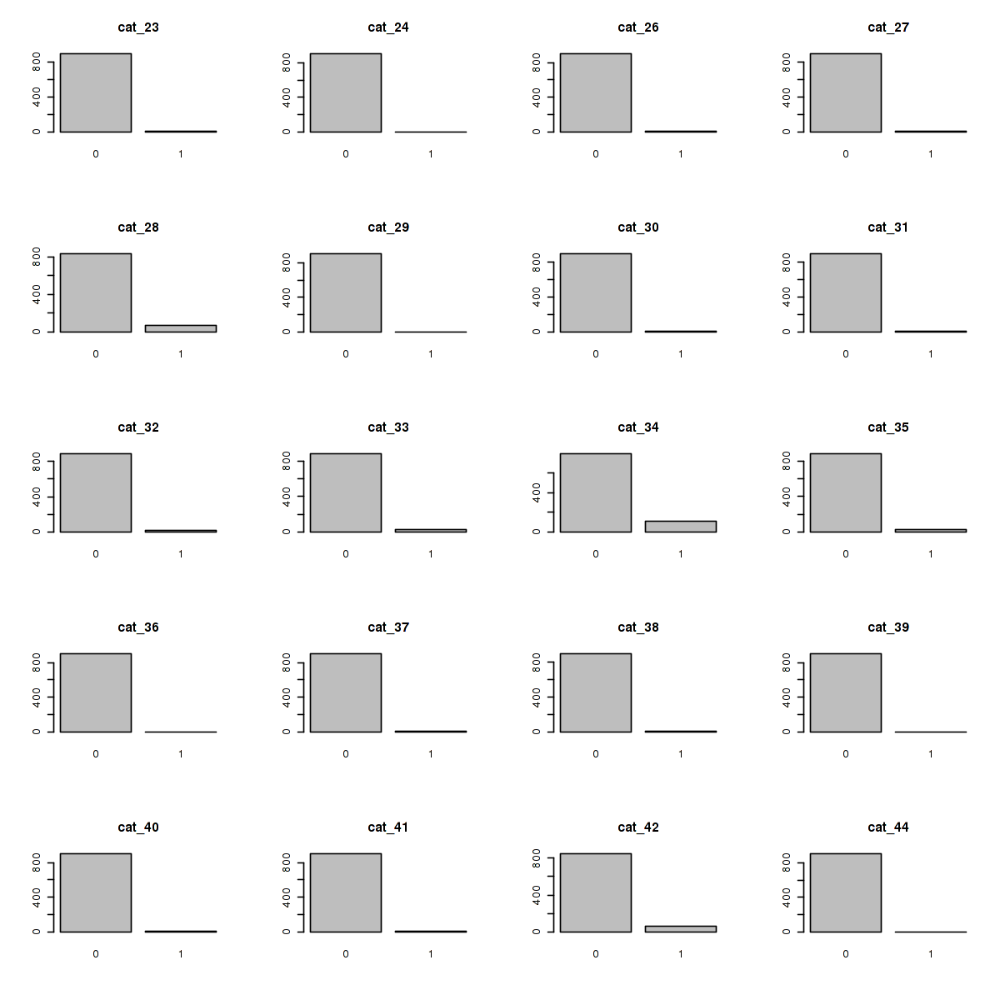

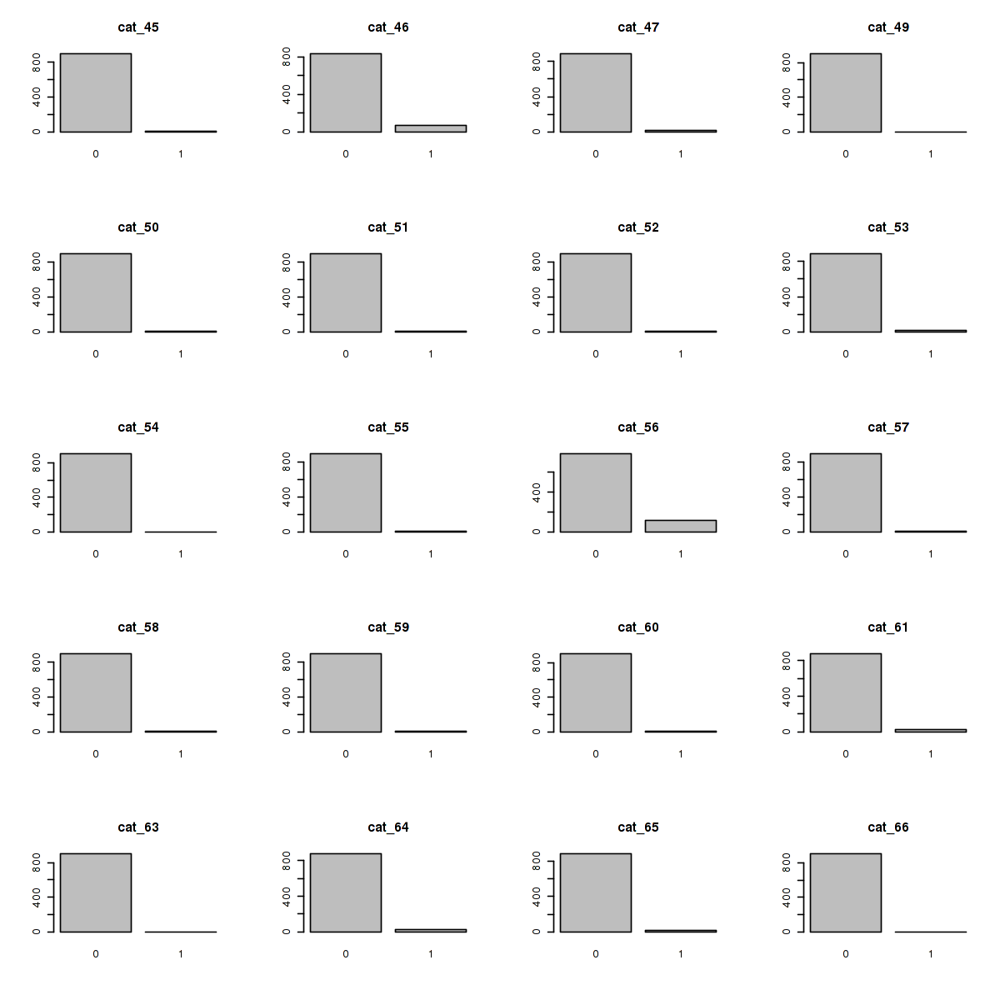

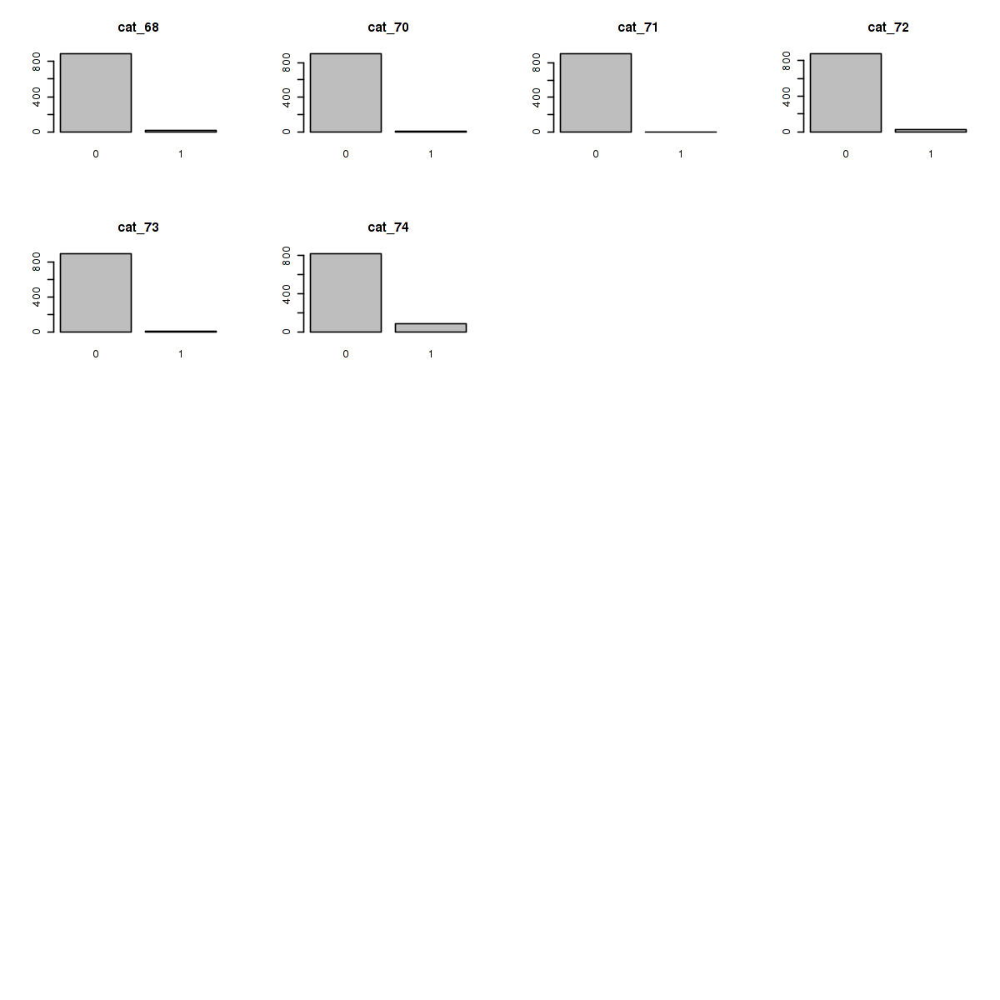

In [86]:

options(repr.plot.width = 10, repr.plot.height = 10)
par(mfrow=c(5,4))
i <- 1
for(y in 1:length(cv)) {
    barplot(table(sellers[[cv[i]]]),main=cv[i])
    i <- i + 1
}


## Serching for patterns on the data

In [ ]:
cv<-

[1] 0.997 0.003 0.000 0.000 0.000

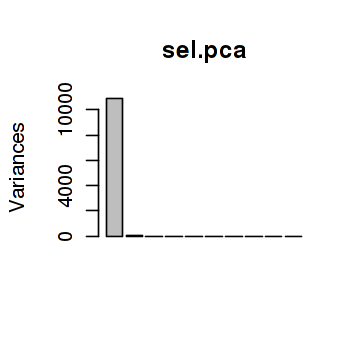

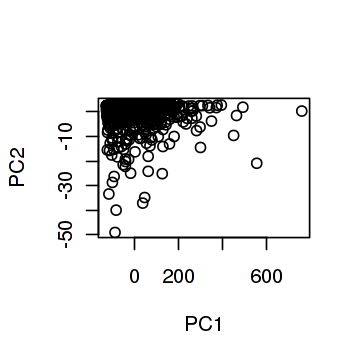

In [98]:
options(repr.plot.width = 3, repr.plot.height = 3)

sel.pca <- prcomp(sellers[c(nv,cv)])

round(sel.pca$sdev^2/sum(sel.pca$sdev^2),3)[1:5]

plot(sel.pca)
plot(sel.pca$x)


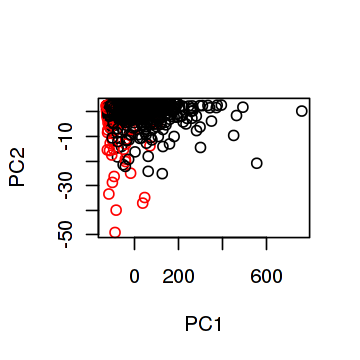

In [92]:
plot(sel.pca$x, col=mout$outliers+1)

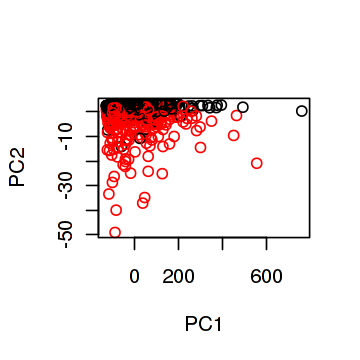

In [93]:
plot(sel.pca$x, col=sellers$outcome+1)